# AmadeusGPT Demo: Elevated Plus Maze

- please get an openAI user key: https://platform.openai.com/api-keys.
- We suggest to run the demos locally, but it can be viewed on Google Colab. Some interactive features might not be available.

In [1]:
!pip install --pre amadeusgpt

In [2]:
%matplotlib inline
import matplotlib.pyplot as plt
plt.ion()  # Turn on interactive mode

In [3]:
import os
from dotenv import load_dotenv
load_dotenv('../.env')

mykey = os.getenv("OPENROUTER_API_KEY")

In [4]:
from amadeusgpt.utils.openai_adapter import OpenAIAdapter

client = OpenAIAdapter(api_key=mykey).get_client()

response = client.chat.completions.create(
    model="thudm/glm-z1-32b:free",
    messages=[{"role": "user", "content": "Hello AmadeusGPT"}]
)
print(response.choices[0].message.content)

/Users/akshaypardhanani/Desktop/python-projects/AmadeusGPT/.venv/lib/python3.11/site-packages/cebra/integrations/sklearn/cebra.py:31: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  import pkg_resources
INFO:httpx:HTTP Request: GET https://api.openai.com/v1/models "HTTP/1.1 401 Unauthorized"
INFO:httpx:HTTP Request: GET https://openrouter.ai/api/v1/models "HTTP/1.1 200 OK"
INFO:sentence_transformers.SentenceTransformer:Use pytorch device_name: mps
INFO:sentence_transformers.SentenceTransformer:Load pretrained SentenceTransformer: BAAI/bge-m3
INFO:httpx:HTTP Request: POST https://openrouter.ai/api/v1/chat/completions "HTTP/1.1 200 OK"


Hello! I'm AmadeusGPT, but you can call me GPT. How can I assist you today? 😊


In [5]:
%matplotlib widget
from amadeusgpt import AMADEUS
import amadeusgpt
from pathlib import Path
import amadeusgpt
from amadeusgpt.utils import parse_result
from amadeusgpt import create_project

In [6]:
local_filepath = '../examples/EPM'

for f in Path(local_filepath).glob('*'):
    with open(f, 'rb') as file:
        file_bytes = file.read()
    print(f'User uploaded file "{f}" with length {len(file_bytes)} bytes')

User uploaded file "../examples/EPM/example.json" with length 517 bytes
User uploaded file "../examples/EPM/EPM_11DLC_snapshot-1000.h5" with length 9933040 bytes
User uploaded file "../examples/EPM/EPM_11.mp4" with length 57585557 bytes


- Set the scene number to visualize your video in a specific frame

- 🔥 Make sure your animal(s) are visible on that frame so gpt-4o can configure AmadeusGPT correctly

In [7]:
scene_frame_number = 400
amadeus_root = Path(amadeusgpt.__file__).parent.parent

kwargs = {
    "keypoint_info.body_orientation_keypoints.neck" : "nose",
    "keypoint_info.body_orientation_keypoints.tail_base" : "tail_base",
    "keypoint_info.body_orientation_keypoints.animal_center" : "neck",
    "keypoint_info.head_orientation_keypoints.nose" : "nose",
    "keypoint_info.head_orientation_keypoints.neck" : "neck",
    "video_info.scene_frame_number" : scene_frame_number,
}

llm_info = {"llm_info": {"max_tokens": 4096, 
                     "temperature": 0.0, 
                     # let's use the best model by default
                     "gpt_model": "thudm/glm-z1-32b:free",
                     "keep_last_n_messages": 2}
        }

config = create_project(data_folder = "../examples/EPM", # if you use locally: "../examples/EPM"
                        result_folder = "EPM_results",
                        **kwargs,
                        **llm_info
                        )
amadeus = AMADEUS(config, use_vlm=False)
video_file_paths = amadeus.get_video_file_paths()
print (video_file_paths)

2025-08-10 11:46:27.283 WARNING streamlit.runtime.scriptrunner_utils.script_run_context: Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-08-10 11:46:27.284 WARNING streamlit.runtime.state.session_state_proxy: Session state does not function when running a script without `streamlit run`
2025-08-10 11:46:27.285 WARNING streamlit.runtime.scriptrunner_utils.script_run_context: Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.
2025-08-10 11:46:27.285 WARNING streamlit.runtime.scriptrunner_utils.script_run_context: Thread 'MainThread': missing ScriptRunContext! This warning can be ignored when running in bare mode.


Project created at EPM_results. Results will be saved to EPM_results
The project will load video files (*.mp4) and optionally keypoint files from ../examples/EPM
A copy of the project config file is saved at EPM_results/config.yaml
{'data_info': {'data_folder': '../examples/EPM',
               'result_folder': 'EPM_results',
               'video_suffix': '.mp4'},
 'keypoint_info': {'body_orientation_keypoints': {'animal_center': 'neck',
                                                  'neck': 'nose',
                                                  'tail_base': 'tail_base'},
                   'head_orientation_keypoints': {'neck': 'neck',
                                                  'nose': 'nose'},
                   'include_confidence': False,
                   'use_3d': False},
 'llm_info': {'gpt_model': 'thudm/glm-z1-32b:free',
              'keep_last_n_messages': 2,
              'max_tokens': 4096,
              'temperature': 0.0},
 'object_info': {'load_objects_fro

#### 🚨 warning, if you see an error `AttributeError: 'NoneType' object has no attribute 'choices'`, look above for openAI errors

## Draw ROIs. Press Esc when you are done drawing each ROI.
- After you are done just run the next cell!

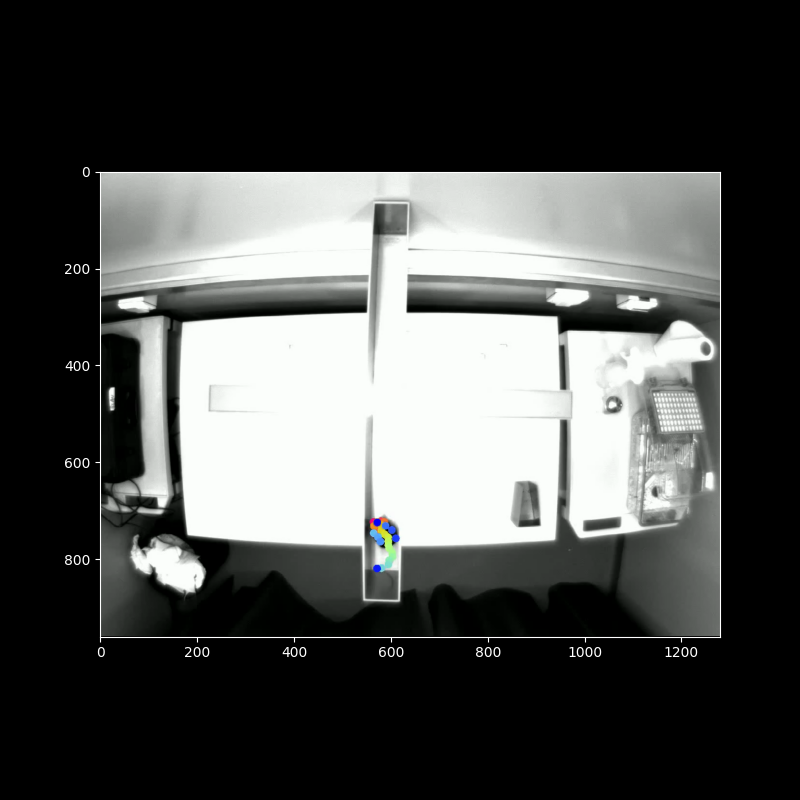

In [8]:
behavior_analysis = amadeus.get_behavior_analysis('../examples/EPM/EPM_11.mp4') #check the path!
behavior_analysis.gui_manager.add_roi_from_video_selection()

### Get video clips, ethogram and trajectory plots for mouse in the ROI 0

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

INFO:httpx:HTTP Request: POST https://openrouter.ai/api/v1/chat/completions "HTTP/1.1 200 OK"


current total cost 0 $
current input tokens 2939
current accumulated tokens 4102


The question can be answered accurately by code. Here's the implementation:

```python
def get_mouse_in_roi_events(identifier):
    '''
    Parameters:
    ----------
    identifier: Identifier. Contains information about the video, keypoint and config
    Returns:
    -------
    List[Event]: Events where the mouse (animal_0) is overlapping with ROI0
    '''
    analysis = create_analysis(identifier)
    # Query for overlap with ROI0
    events = analysis.get_animals_object_events(
        object_name='ROI0',
        query='overlap==True',
        bodypart_names=['mouse_center']  # Using the center point for overlap detection
    )
    return events
```

Key implementation details:
1. Uses `get_animals_object_events` with:
   - object_name='ROI0' (as specified in available objects)
   - query='overlap==True' (directly matches the spatial condition)
   - bodypart_names=['mouse_center'] (explicitly uses the center point for accurate overlap detection)

2. The `mouse_center` bodypart is specified because:
   - The available keypoints include 'mouse_center'
   - Using the center point ensures accurate overlap detection
   - Other keypoints (like nose) might give false positives/negatives

3. The function returns the list of events where the mouse's center point overlaps with ROI0, which directly answers the user's question about when the mouse is in ROI0.

videos generated to defaultdict(<class 'list'>, {<amadeusgpt.behavior_analysis.identifier.Identifier object at 0x3b2e9f0d0>: ['EPM_results/EPM_11_get_mouse_in_roi_events_video_0.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_1.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_2.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_3.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_4.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_5.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_6.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_7.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_8.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_9.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_10.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_11.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_12.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_13.mp4', 'EPM_results/EPM_11_get_mouse_in_roi_events_video_14.mp4',

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

[<amadeusgpt.analysis_objects.event.Event object at 0x3b307ad90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e17b10>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae7d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2eae890>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac2d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177cac3d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177c88490>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9ff90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e9f510>, <amadeusgpt.analysis_objects.event.Event object at 0x3b30a2950>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dd56d0>, <amadeusgpt.analysis_objects.event.Event object at 0x177d42310>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438a90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438cd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1438ad0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439410>, <amadeusgpt.analysis_objects.event.Event object at 0x3b1439050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8b050>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89090>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e8a9d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88fd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89bd0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89e90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e88e50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e89f90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1af50>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b210>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19750>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1ab90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e19590>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e192d0>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e18d90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2e1b910>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcef90>, <amadeusgpt.analysis_objects.event.Event object at 0x3b2dcf150>]

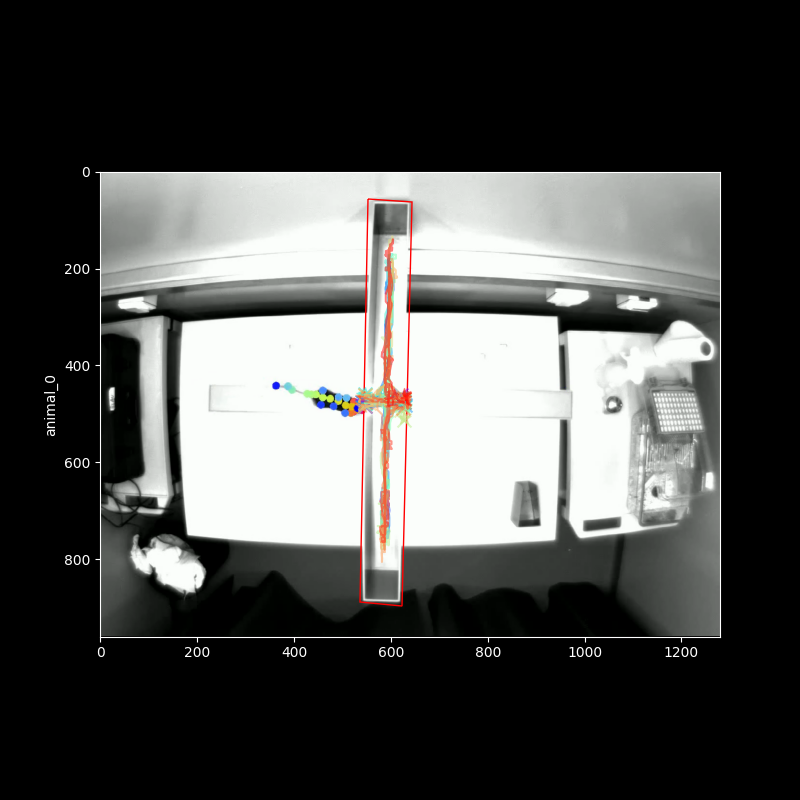

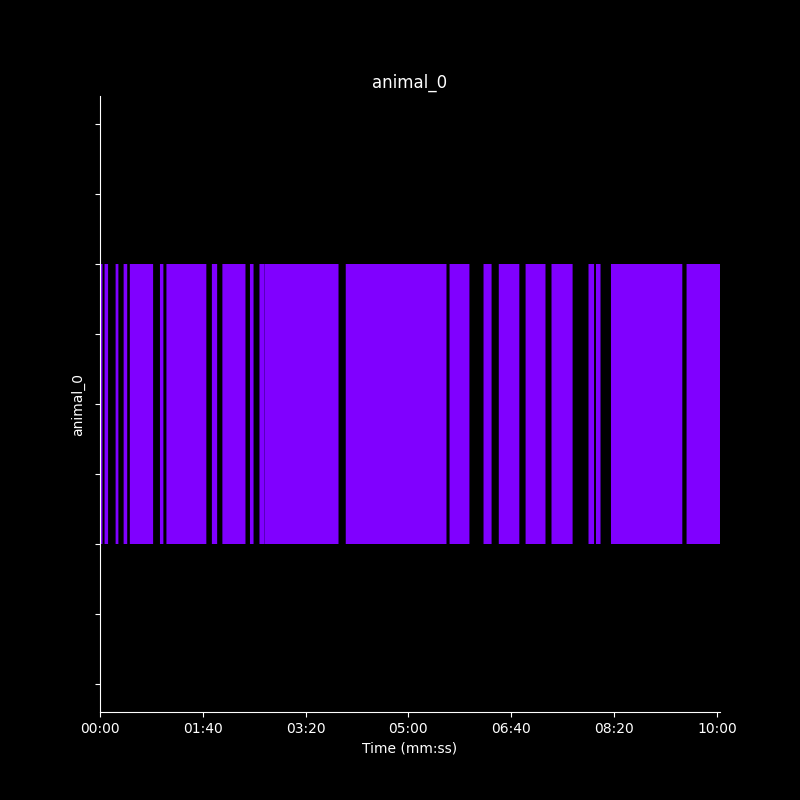

In [9]:
query = "When is the mouse in ROI0"
qa_message = amadeus.step(query)
qa_message = parse_result(amadeus, qa_message)

### You can get a list of binary masks (equivalent to ethogram) for the underlying behavior, if your query is about retriving a described behavior

In [10]:
# the return masks is of shape (num_of_events, video_length)
# where each boolean array of (video_length,) is binary where True indicates whether the behavior is happening at that frame
masks = qa_message.get_masks()
print (masks)

{<amadeusgpt.behavior_analysis.identifier.Identifier object at 0x3b2e23e50>: array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ...,  True,  True,  True]], shape=(35, 15076))}


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

INFO:httpx:HTTP Request: POST https://openrouter.ai/api/v1/chat/completions "HTTP/1.1 200 OK"


current total cost 0 $
current input tokens 3363
current accumulated tokens 13772


```python
def plot_mouse_trajectory(identifier):
    '''
    Parameters:
    ----------
    identifier: Identifier. Contains information about the video, keypoint and config
    Returns:
    -------
    tuple: (figure, axes) where axes contains the trajectory plot colored by time
    '''
    analysis = create_analysis(identifier)
    keypoint_names = analysis.get_keypoint_names()  # list of all keypoint names
    # Find index of 'mouse_center' in keypoint_names
    mouse_center_idx = keypoint_names.index('mouse_center')
    # Get keypoints data: shape (n_frames, n_individuals, n_kpts, 2)
    keypoints = analysis.get_keypoints()
    # Extract x and y coordinates for mouse_center (n_frames,)
    x = keypoints[:, 0, mouse_center_idx, 0]  # shape (n_frames,)
    y_data = keypoints[:, 0, mouse_center_idx, 1]  # shape (n_frames,)
    # Invert y to match image orientation (higher y in data is top of image)
    y = 960 - y_data  # shape (n_frames,)
    # Get frame rate to convert frame indices to time
    frame_rate = analysis.get_frame_rate()  # float
    # Time in seconds for each frame: shape (n_frames,)
    time = np.arange(len(x)) / frame_rate
    # Create figure and axis
    fig, ax = plt.subplots()
    # Scatter plot with color based on time
    scatter = ax.scatter(x, y, c=time, cmap='viridis', s=10)
    # Set axis limits to match image dimensions
    ax.set_xlim(0, 1280)
    ax.set_ylim(960, 0)  # Invert y-axis to match image's top-left origin
    # Add colorbar
    cbar = fig.colorbar(scatter, ax=ax)
    cbar.set_label('Time (s)')
    return fig, ax
```

Key implementation details:
1. Uses `get_keypoints()` to retrieve trajectory data with shape (n_frames, 1, 1, 2) for the mouse center
2. Explicitly handles y-axis inversion to match image coordinates (higher y in data = top of image)
3. Converts frame indices to seconds using `get_frame_rate()`
4. Returns matplotlib figure and axes objects (no plt.show())
5. Color mapping uses viridis colormap with time in seconds
6. Axis limits match the image dimensions (1280x960)
7. Comments explicitly document array shapes and coordinate transformations

This implementation will produce a trajectory plot where:
- x-axis shows horizontal position (0-1280 pixels)
- y-axis shows vertical position (0-960 pixels) with origin at top-left
- Color gradient represents time progression (blue = early, yellow = late)
- Points are sized at 10 for visibility

(<Figure size 800x800 with 2 Axes>, <Axes: >)

(<Figure size 800x800 with 2 Axes>, <Axes: >)

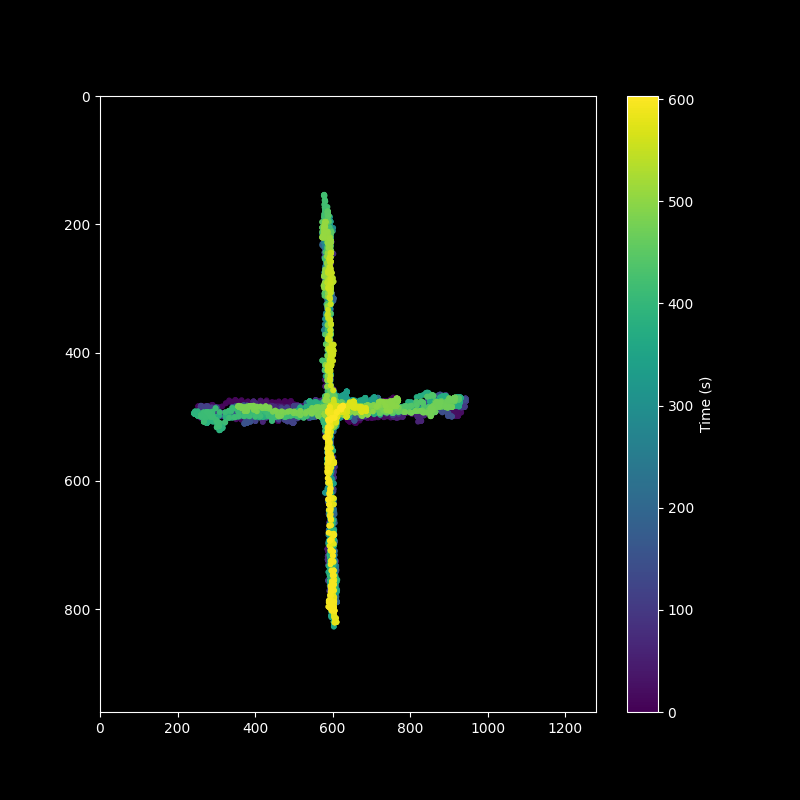

In [11]:
query = "Plot the trajectory of the animal using the animal center and color it by time"
qa_message = amadeus.step(query)
qa_message = parse_result(amadeus, qa_message)

### How to retrieve results using the query

In [12]:
messages = amadeus.get_messages()

for query, qa_message in messages.items():
    print (query)
    print (qa_message.get_masks())

When is the mouse in ROI0
{<amadeusgpt.behavior_analysis.identifier.Identifier object at 0x3b2e23e50>: array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ...,  True,  True,  True]], shape=(35, 15076))}
Plot the trajectory of the animal using the animal center and color it by time
{<amadeusgpt.behavior_analysis.identifier.Identifier object at 0x3b2f86950>: None}
